# HIO's Initial Master File For Implementing Detectron2's Mask-RCNN

<img src="https://www.washingtonpost.com/wp-srv/special/national/nasa-iss/img/ISS-2011.png" width="500">

INSERT DESCRIPTION HERE



#Step 1: Install detectron2

In [ ]:
!pip install pyyaml==5.1
# This is the current pytorch version on Colab. Uncomment this if Colab changes its pytorch version
!pip install torch==1.9.0+cu102 torchvision==0.10.0+cu102 -f https://download.pytorch.org/whl/torch_stable.html

# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu102/torch1.9/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

     |████████████████████████████████| 274 kB 5.0 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=c893958d1b0827cce8e26fafc41832f5fc8355d243591e94929fe44794b092ef
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 831.4 MB 3.0 kB/s 
     |████████████████████████████████| 22.1 MB 1.3 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.10.0+cu111
    Uninstalling torch-1.10.0+cu111:
      Successfully uninstalled torch-1.10.0+cu111
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.11.1+cu111
    Uninstalling torchvision-0.11.1+cu111:
      Succ

##Step1.1: Check Installation was successfull

In [ ]:
# check pytorch installation: 
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
assert torch.__version__.startswith("1.9")   # please manually install torch 1.9 if Colab changes its default version

1.9.0+cu102 True


##Step 1.2: Import libraries and utilities

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
#!python --version
print(torch.__version__)
print(torchvision.__version__)
#conda install pytorch==1.9.0 torchvision==0.10.0 -c pytorch


1.9.0+cu102
0.10.0+cu102


#Step 2: Import Training and Evaluation Datasets

In [ ]:
# Load the Drive helper and mount
from google.colab import drive
drive.mount('/content/drive')

# copy it there
%cd drive/MyDrive/
!cp handrail7.zip /content/
!cp output.zip /content/
# !cp "Spacewalk at the International Space Station 1-28-31 screenshot.png" /content/
# !cp "Spacewalk at the International Space Station 1-34-24 screenshot.png" /content/
# !cp "unnamed (2).jpg" /content/
# !cp "TESTSPACE.jpg" /content/
# !cp "eva_vid.mp4" /content/
# !cp "IMG_0548.HEIC" /content/
!cp "IMG_0548.jpg" /content/
!cp "IMG_0548_ONLY_CRAFT.jpg" /content/
!cp "IMG_0548_ONLY_HANDRAILS.jpg" /content/
%cd ..
%cd ..
!dir

!unzip handrail7.zip > /dev/null
!unzip output.zip > /dev/null

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive
/content/drive
/content
drive	   handrail7.zip  IMG_0548_ONLY_CRAFT.jpg      output	   sample_data
handrail7  IMG_0548.jpg   IMG_0548_ONLY_HANDRAILS.jpg  output.zip
replace handrail7/train/cktv0pc1511rg0y6x9zwieo14.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
replace output/events.out.tfevents.1639813332.362160a03849.73.0? [y]es, [n]o, [A]ll, [N]one, [r]ename: A


#Step 3: Prepare dataset for training

In [ ]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
# from detectron2.data.datasets import register_coco_instances
# register_coco_instances("my_dataset_train", {}, "json_annotation_train.json", "path/to/image/dir")
# register_coco_instances("my_dataset_val", {}, "json_annotation_val.json", "path/to/image/dir")

from detectron2.structures import BoxMode

def get_handrail_dicts(img_dir):
    json_file = os.path.join(img_dir, "via_region_data.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for idx, v in enumerate(imgs_anns.values()):
        record = {}
        
        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]
        
        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width
      
        annos = v["regions"]
        objs = []
        # Mu
        for _, anno in annos.items():
            #assert not anno["region_attributes"]
            anno_shp = anno["shape_attributes"]
            px = anno_shp["all_points_x"]
            py = anno_shp["all_points_y"]
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]
            h_class = anno["region_attributes"]["title"]
            
            # # Multi Class Handrails
            # cat_num = 0
            # if h_class == "handrail_cone":
            #     cat_num = 0
            # if h_class == "handrail_ring":
            #     cat_num = 1
            # if h_class == "handrail_box":
            #     cat_num = 2

            # Single Class Handrails
            cat_num = 0

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": cat_num,
            }

            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

for d in ["train", "val"]:
    DatasetCatalog.register("handrail_" + d, lambda d=d: get_handrail_dicts("handrail7/" + d))  #.# folder specific

    # multiClasses = ["Cone","Ring","Box"]
    singleClass = ["Handrail"]
    MetadataCatalog.get("handrail_" + d).set(thing_classes=singleClass)

handrail_metadata = MetadataCatalog.get("handrail_train")

##Step 3.1: Verify the data loading is correct by visualizing the annotations of  selected samples in the dataset



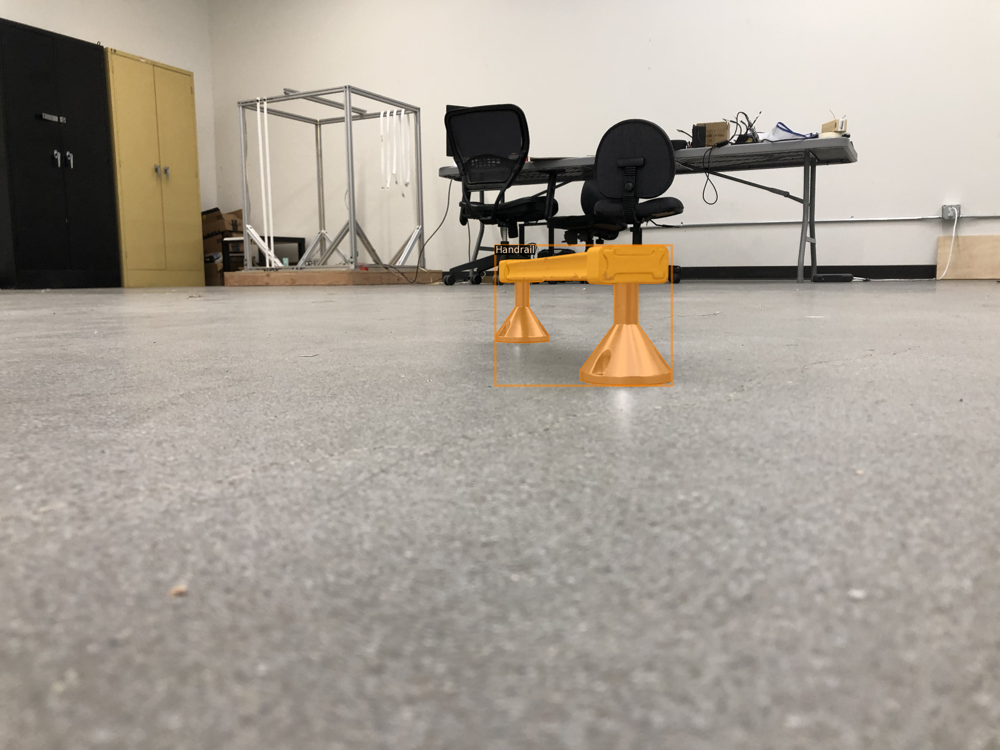

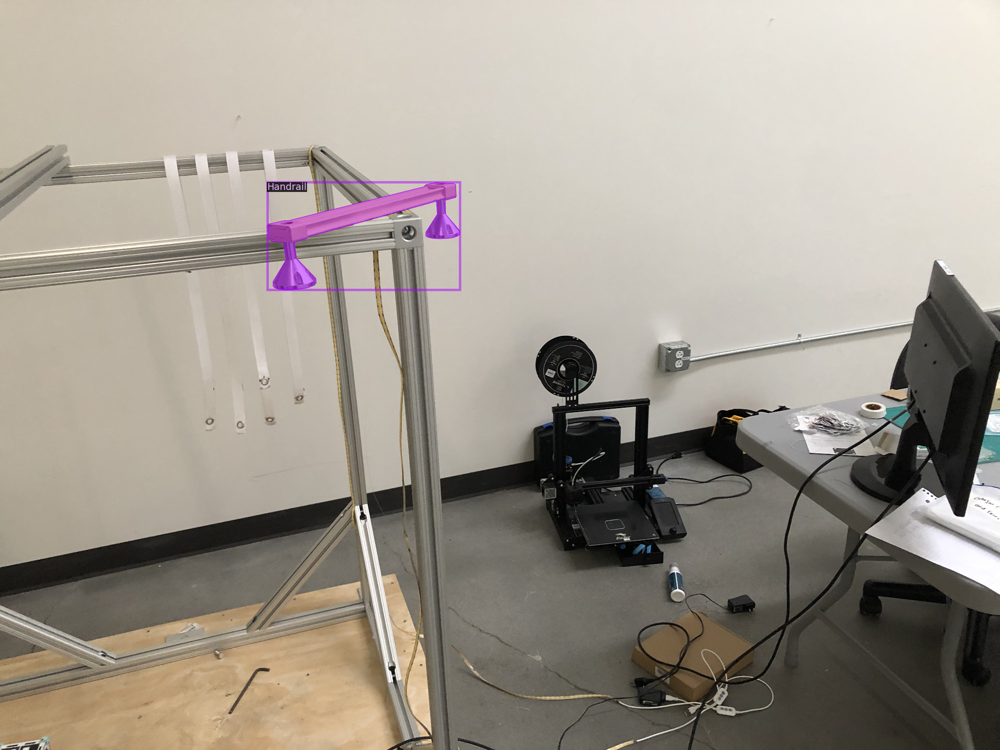

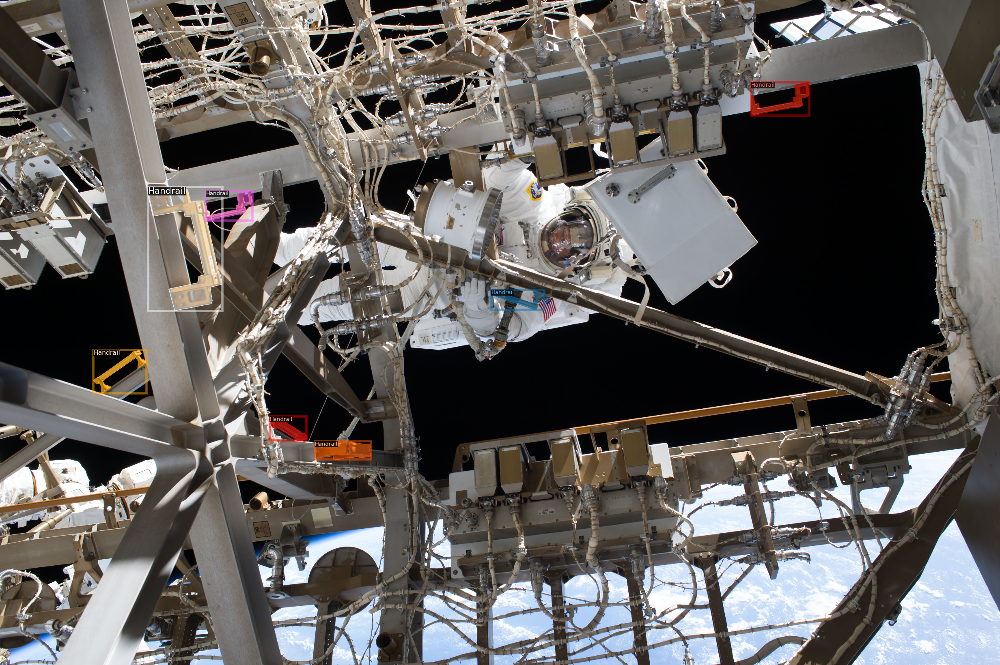

In [ ]:
# MULTIPLE IMAGES
dataset_dicts = get_handrail_dicts("handrail7/val")   #.# folder specific
for d in dataset_dicts[0:3]:
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=handrail_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])


#Step 4: Select Training Parameters and Train

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the balloon dataset. It takes ~2 minutes to train 300 iterations on a P100 GPU.


In [ ]:
# HANDRAIL P4: Import COCO weights as base and Set Training Hyperparameters for Turning Weights
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("handrail_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 8000    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)


# trainer = DefaultTrainer(cfg) 
# trainer.resume_or_load(resume=False)
# trainer.train()

#Step 5: View Trining Metrics

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# Step 6: Inference & evaluation using the trained model
Now, let's run inference with the trained model on the balloon validation dataset. First, let's create a predictor using the model we just trained



In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_0004999.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

#Step 7: View detections for selected images in the validation dataset

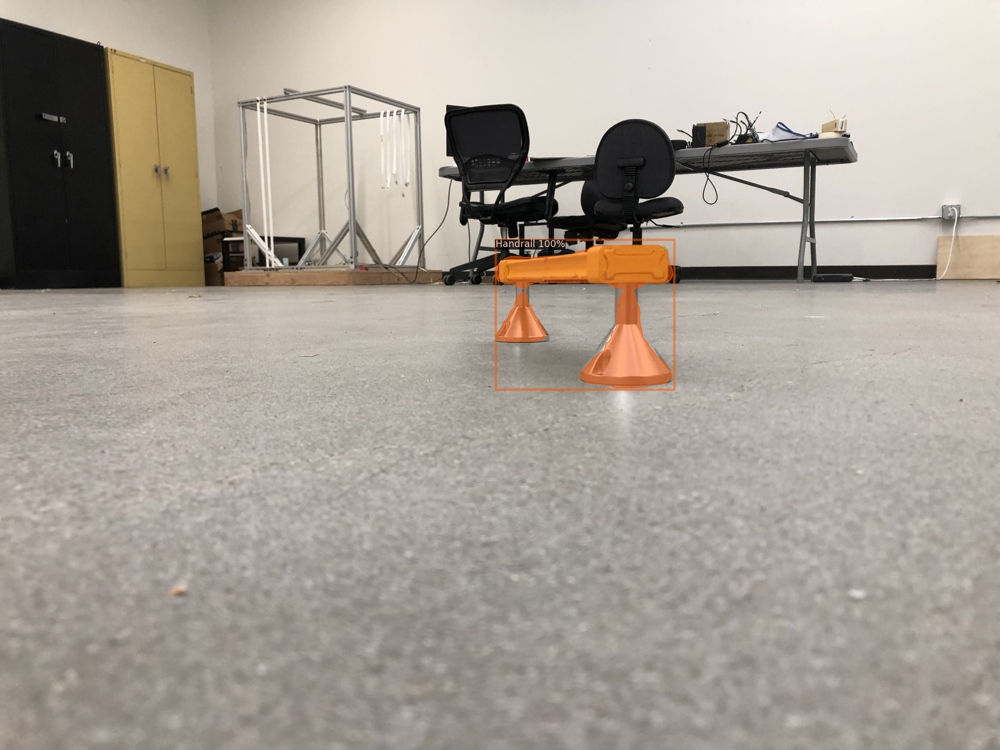

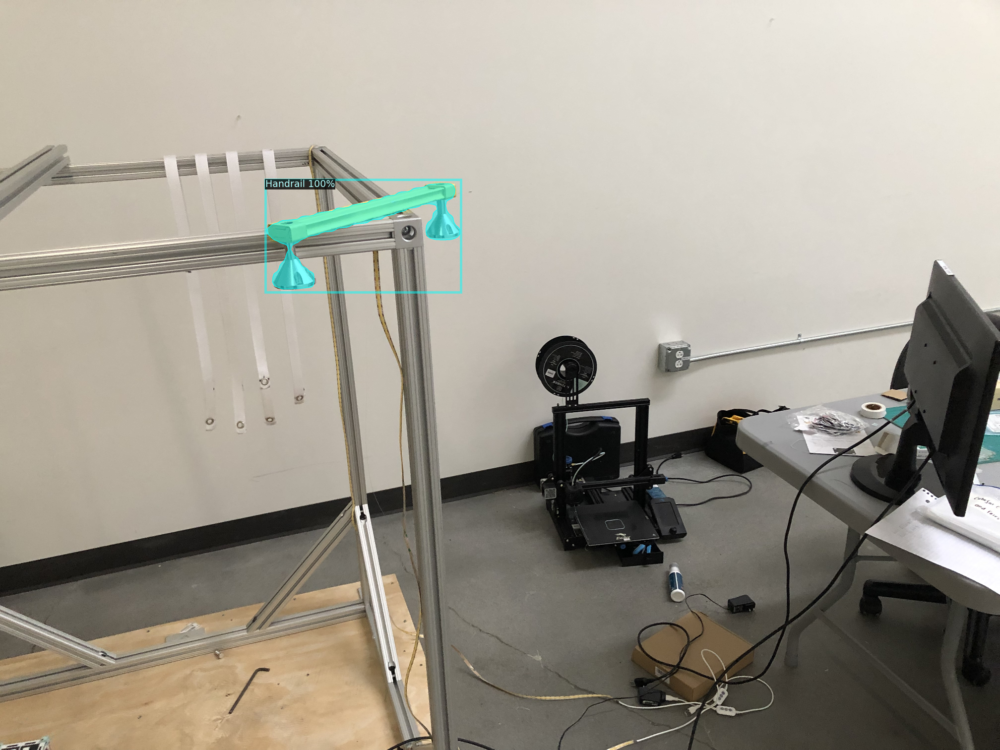

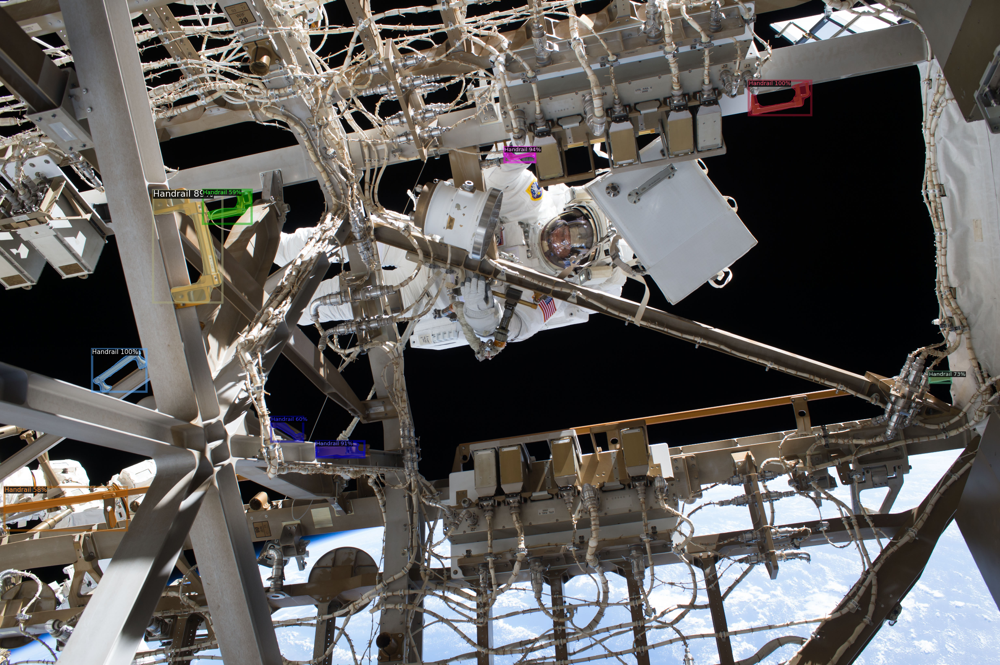

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_handrail_dicts("handrail7/val")
for d in dataset_dicts[0:3]:    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=handrail_metadata, 
                   scale=0.5,) 
                  #  instance_mode=ColorMode.IMAGE_BW)   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

handrail7/val/ckurqv0201ild0zd50mwzcl33.jpg


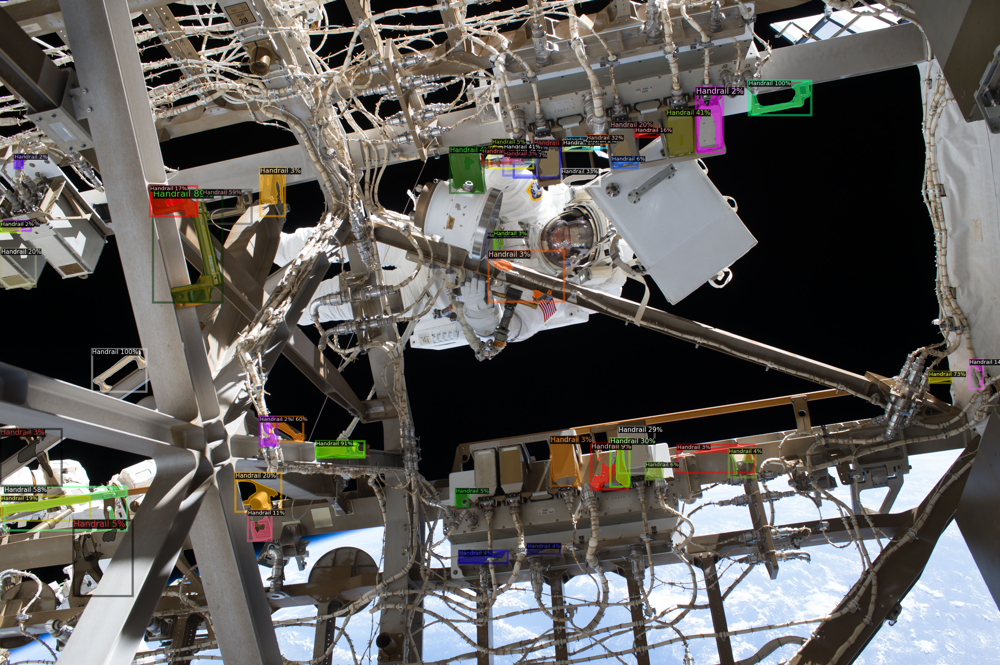

In [ ]:
# HANDRAIL P8: View detections on chosen image
val_img = dataset_dicts[2]
img = val_img["file_name"]
org_image_path = img
print(img)
im = cv2.imread(img)
# im = cv2.imread("Spacewalk at the International Space Station 1-34-24 screenshot.png")
outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
v = Visualizer(im[:, :, ::-1],
                metadata=handrail_metadata, 
                scale=0.5,) 
                # instance_mode=ColorMode.IMAGE_BW)   # remove the colors of unsegmented pixels. This option is only available for segmentation models
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
#Handrail P9: Output Bbox coordinates, confidence, and IOU ranking for each detection
from tabulate import tabulate
import numpy as np

def BB_IOU(boxA, boxB):
    """https://gist.github.com/meyerjo/dd3533edc97c81258898f60d8978eddc"""
    # determine the (x, y)-coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    # compute the area of intersection rectangle
    interArea = abs(max((xB - xA, 0)) * max((yB - yA), 0))
    if interArea == 0:
        return 0
    # compute the area of both the prediction and ground-truth
    # rectangles
    boxAArea = abs((boxA[2] - boxA[0]) * (boxA[3] - boxA[1]))
    boxBArea = abs((boxB[2] - boxB[0]) * (boxB[3] - boxB[1]))

    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    iou = interArea / float(boxAArea + boxBArea - interArea)
    # return the intersection over union value
    return iou


detect_bbox = outputs["instances"].pred_boxes.tensor.cpu().numpy()
detect_score = outputs["instances"].scores.cpu().numpy()
detect_class = outputs["instances"].pred_classes.cpu().numpy()
detect_mask = outputs["instances"].to("cpu").pred_masks.numpy()
num_detect = len(outputs["instances"].pred_boxes.tensor)
# print(outputs["instances"])
# print("Everything in Outputs: ",outputs)


# GATHER TRUTHS PER IMAGE
len(val_img['annotations'])
truths = []
for i in range(len(val_img['annotations'])):
  truths.append(val_img['annotations'][i]['bbox'])

# GATHER BBOX COODINATES, CONFIDENCE, AND IOU FOR EACH DETECTION PER IMAGE
det_dict = {}
for i in range(num_detect):
  det_dict[i] = {"bbox":{}, "conf":{}, "IOU":{}}
  det_dict[i]["bbox"] = list(detect_bbox[i])
  det_dict[i]["conf"] = round(detect_score[i],3)

  iou_list = []
  tp_threshold = 0                  # iou value necessary to be a true positive
  truePos = False
  for j in range(len(truths)):
    truth_bbox = val_img['annotations'][j]['bbox']
    iou = round(BB_IOU(truth_bbox,detect_bbox[i]),3)
    iou_list.append(iou)
    if iou > tp_threshold:
      truePos = True
  det_dict[i]["IOU"] = iou_list
  det_dict[i]["TP?"] = truePos

# print(det_dict)


spc1 = "                 "
spc2 = "              "
headers = ["Detection","Bbox"+spc1+spc1+spc1+"Conf"+spc2+"IOU"+spc2+spc2+"True Positive?"] 
table = tabulate(det_dict.items(),headers = headers)
print(table)

eta = val_img['annotations'][0]['bbox']
# print(len(val_img['annotations']))
# print(truths)

  Detection  Bbox                                                   Conf              IOU                            True Positive?
-----------  ------------------------------------------------------------------------------------------------------------------------
          0  {'bbox': [3690.1355, 398.60562, 3997.3171, 568.5226], 'conf': 1.0, 'IOU': [0, 0, 0, 0, 0, 0.882, 0], 'TP?': True}
          1  {'bbox': [454.1297, 1722.58, 722.1208, 1931.4254], 'conf': 0.999, 'IOU': [0.921, 0, 0, 0, 0, 0, 0], 'TP?': True}
          2  {'bbox': [2486.9668, 725.4584, 2637.8174, 799.9837], 'conf': 0.935, 'IOU': [0, 0, 0, 0, 0, 0, 0], 'TP?': False}
          3  {'bbox': [1558.699, 2175.6714, 1795.7094, 2255.262], 'conf': 0.906, 'IOU': [0, 0, 0, 0, 0, 0, 0.737], 'TP?': True}
          4  {'bbox': [754.83044, 938.3886, 1095.9381, 1491.8125], 'conf': 0.888, 'IOU': [0, 0, 0, 0.84, 0.056, 0, 0], 'TP?': True}
          5  {'bbox': [4577.968, 1833.1101, 4687.5723, 1888.2246], 'conf': 0.725, 'IOU': [0, 0, 

Hi!
I am working with Mask-RCNN on Detectron 2 and noticed the output bounding boxes include rows and columns of pixels that do not contain any mask pixels. In the picture, you see I would have assumed that each bounding boxes would be defined by the minimum and maximum pixel coordinates of each detection.

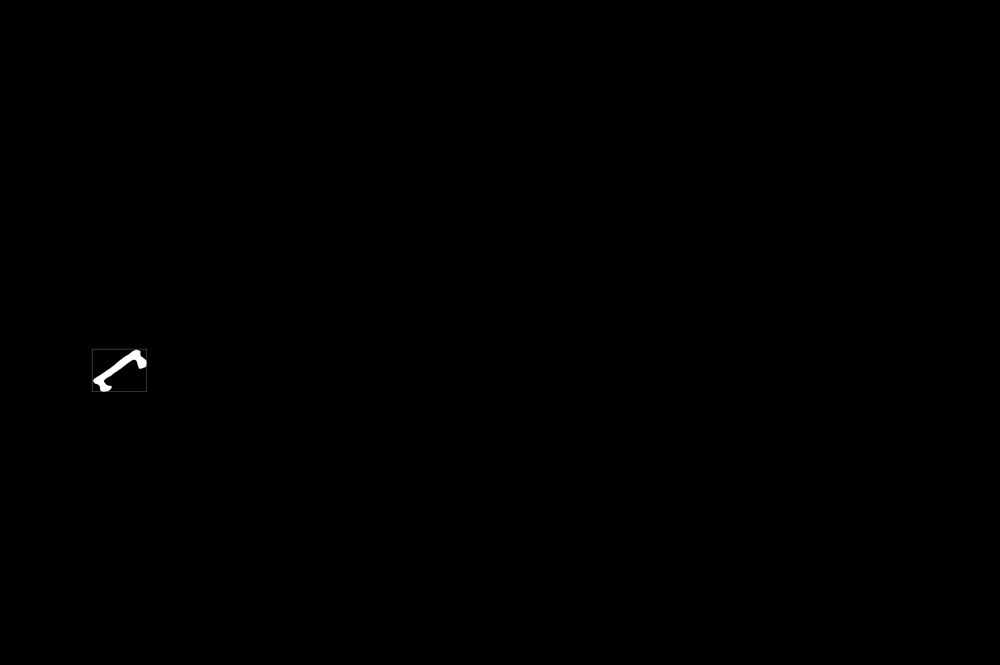

In [ ]:
from PIL import Image

# Display BW Pixel Image
img = detect_mask[1].astype(int)

img = np.array(img, np.uint8)*255
data = Image.fromarray(img)
data.save('single.png')
image = cv2.imread("single.png")
detect0_bbox = detect_bbox[1]
image = cv2.rectangle(image, (detect0_bbox[0],detect0_bbox[1]), (detect0_bbox[2],detect0_bbox[3]), (255, 255, 255), 1)
cv2_imshow(image)

# # Display RGB Pixel Image STILL UNDER CONSTRUCTION
# img = np.zeros([500,500,3])         #RGB
# h,w = img.shape[0], img.shape[1]      
# img[:,:,0] = np.ones([h,w])*255     #R
# img[:,:,1] = np.ones([h,w])*255     #G
# img[:,:,2] = np.ones([h,w])*255     #B
# cv2_imshow(img)

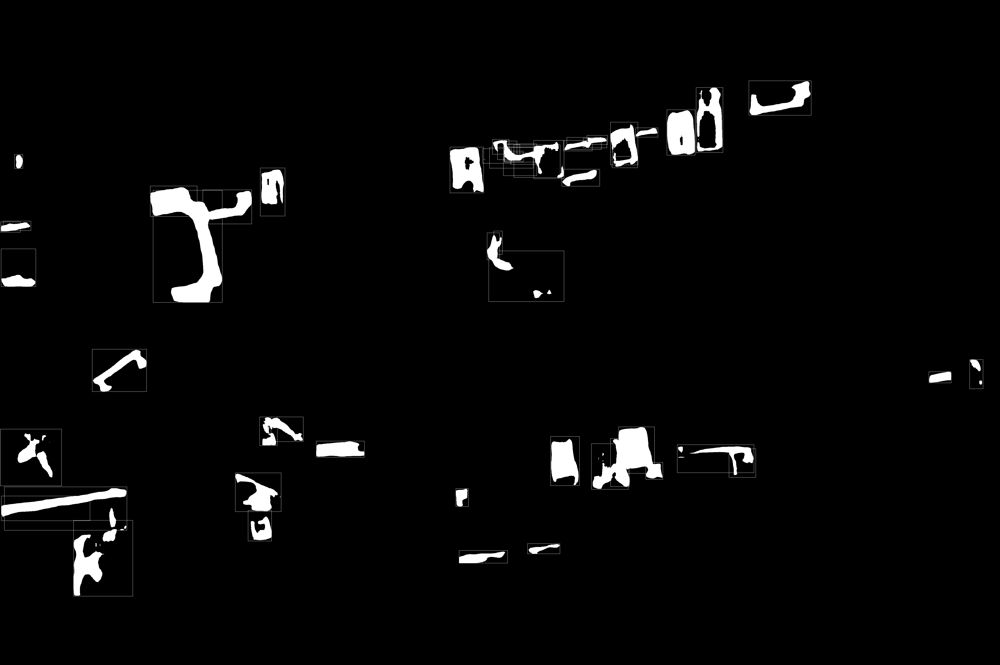

In [ ]:
from PIL import Image

def displaymask(org_image_path, mask_array):
    num_instances = mask_array.shape[0]
    mask_array = np.moveaxis(mask_array, 0, -1)
    mask_array_instance = []
    img = cv2.imread(str(org_image_path))
    output = np.zeros_like(img)
    for i in range(num_instances):
        mask_array_instance.append(mask_array[:, :, i:(i+1)])
        output = np.where(mask_array_instance[i] == True, 255,output)
    im = Image.fromarray(output)

    return im 

maskarray = outputs["instances"].to("cpu").pred_masks.numpy()
masksImg = displaymask(org_image_path, maskarray)
masksImg.save("multi.png")
masks_bboxs_Img = cv2.imread("multi.png")

num_detect = len(outputs["instances"].pred_boxes.tensor)
detect_bbox = outputs["instances"].pred_boxes.tensor.cpu().numpy()
for i in range(num_detect):
  detect_i_bbox = detect_bbox[i]
  masks_bboxs_Img = cv2.rectangle(masks_bboxs_Img, (detect_i_bbox[0],detect_i_bbox[1]), (detect_i_bbox[2],detect_i_bbox[3]), (255, 255, 255), 1)

cv2_imshow(masks_bboxs_Img)
